In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

from os import path
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

import descartes
import geopandas as gpd
from shapely.geometry import Point, Polygon

In [3]:
df1 = pd.read_csv('../csv/rest_cleaned.csv')
df2 = pd.read_csv('../csv/lat_lon.csv')

In [4]:
df = pd.merge(df1, df2, on='names', how='left')

A few of the restaurants have duplicate entries so we drop the entries that have a common name and location.

In [5]:
r = df.drop_duplicates(subset=['names','location_x'])

We will convert the cuisine, category and featured lists that are in str format to lists, for accessibility.

In [6]:
r['category'] = r['category'].apply(lambda x : np.nan if pd.isnull(x) else x.split(','))

r['cuisine'] = r['cuisine'].apply(lambda x : np.nan if pd.isnull(x) else x.split(','))

r['featured'] = r['featured'].apply(lambda x : np.nan if pd.isnull(x) else x.split(','))

In [7]:
r.shape

(1050, 12)

In [8]:
r.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1050 entries, 0 to 1061
Data columns (total 12 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   names       1050 non-null   object 
 1   category    855 non-null    object 
 2   rating      1045 non-null   float64
 3   reviews     559 non-null    float64
 4   cost        1050 non-null   float64
 5   cuisine     1050 non-null   object 
 6   featured    427 non-null    object 
 7   location_x  1050 non-null   object 
 8   urls        1050 non-null   object 
 9   location_y  1048 non-null   object 
 10  lat         1048 non-null   float64
 11  lon         1048 non-null   float64
dtypes: float64(5), object(7)
memory usage: 106.6+ KB


we can fill the 5 missing ratings with it's mode.

In [9]:
r['rating'].fillna(r['rating'].mode()[0], inplace=True)

In [10]:
r.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1050 entries, 0 to 1061
Data columns (total 12 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   names       1050 non-null   object 
 1   category    855 non-null    object 
 2   rating      1050 non-null   float64
 3   reviews     559 non-null    float64
 4   cost        1050 non-null   float64
 5   cuisine     1050 non-null   object 
 6   featured    427 non-null    object 
 7   location_x  1050 non-null   object 
 8   urls        1050 non-null   object 
 9   location_y  1048 non-null   object 
 10  lat         1048 non-null   float64
 11  lon         1048 non-null   float64
dtypes: float64(5), object(7)
memory usage: 146.6+ KB


In [11]:
r.describe()

,rating,reviews,cost,lat,lon
count,1050.000000,559.000000,1050.000000,1048.000000,1048.000000
mean,4.280286,764.173524,912.238095,19.103497,72.873377
std,0.198618,1125.622799,973.333799,0.103697,0.071194
min,3.500000,10.000000,50.000000,18.913755,72.773638
25%,4.200000,105.000000,300.000000,19.039571,72.829624
50%,4.300000,369.000000,550.000000,19.100385,72.840185
75%,4.400000,968.500000,1200.000000,19.173809,72.889905
max,4.900000,9241.000000,10000.000000,19.464550,73.187439


First we will check out the distribution of the quantative values using histograms.

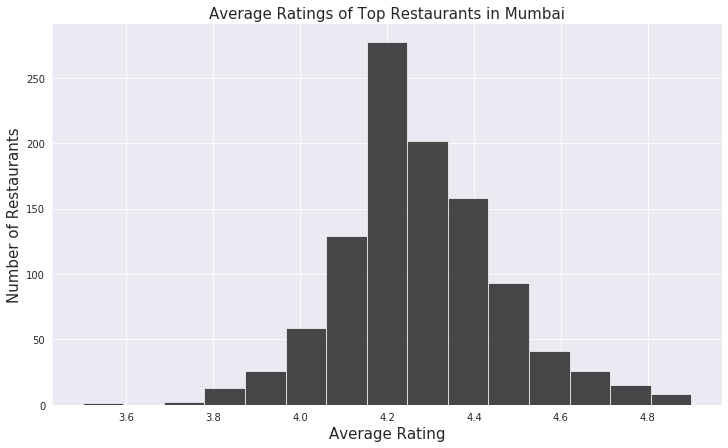

In [16]:
# Ratings

plt.figure(figsize=(12,7))
sns.set_style('darkgrid')
sns.distplot(r['rating'], kde=False, bins = 15, color='#000000', hist_kws={'alpha':0.7})
sns.despine()
plt.title("Average Ratings of Top Restaurants in Mumbai", fontsize = 15)
plt.xlabel("Average Rating", fontsize = 15)
plt.ylabel("Number of Restaurants", fontsize = 15)
plt.savefig('../images/rating_hist.png', bbox_inches='tight')

the average rating follows a normal distribution with the mode being 4.2

Text(0.5, 0, 'Number of Reviews')

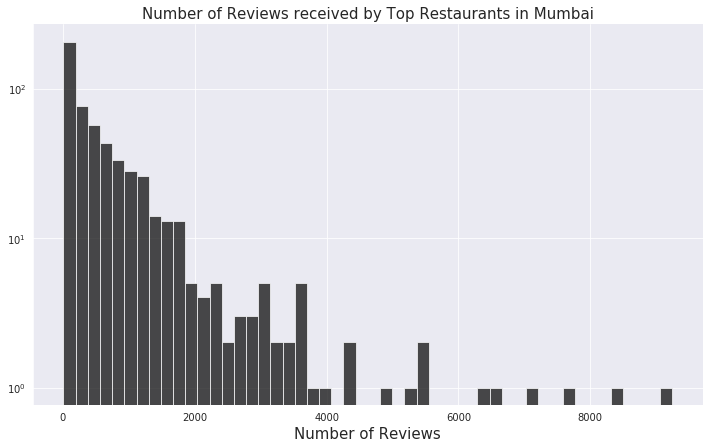

In [14]:
# Reviews

plt.figure(figsize=(12,7))
sns.set_style('darkgrid')
sns.distplot(r['reviews'], kde=False, bins = 50, color='#000000', hist_kws={'alpha':0.7}).set_yscale('log')
sns.despine()
plt.title("Number of Reviews received by Top Restaurants in Mumbai", fontsize = 15)
plt.xlabel("Number of Reviews", fontsize = 15)

note that y axis is log ( 1, 10, 100, 1000, ...)

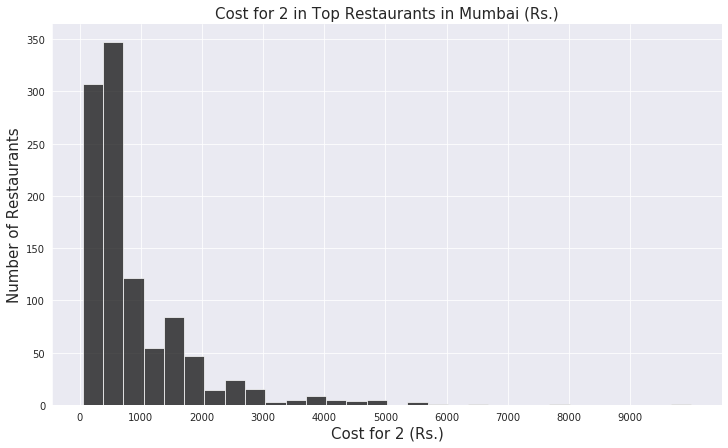

In [15]:
# Cost for 2

plt.figure(figsize=(12,7))
sns.set_style('darkgrid')
sns.distplot(r['cost'], kde=False, bins = 30, color='#000000', hist_kws={'alpha':0.7})
sns.despine()
plt.title("Cost for 2 in Top Restaurants in Mumbai (Rs.)", fontsize = 15)
plt.xlabel("Cost for 2 (Rs.)", fontsize = 15)
plt.ylabel("Number of Restaurants", fontsize = 15)
plt.xticks(np.arange(0,10000,1000))
plt.savefig('../images/cost_hist.png', bbox_inches='tight')

Majority of the places cost < 1000 Rs. for two.

Now we will look at the 10 highest rated and the 10 lowest rated restaurants.

In [17]:
top_10_best_rated = r.sort_values(by=['rating', 'reviews'], ascending=False).head(10)
top_10_best_rated[['names','category','rating','reviews','cost','cuisine']]

,names,category,rating,reviews,cost,cuisine
0,Yauatcha,[Fine Dining],4.9,6513.0,2800.0,"[Asian, Cantonese, Chinese]"
1,Hotel Ram Ashraya,[Quick Bites],4.9,5471.0,200.0,"[South Indian, Beverages]"
3,K. Rustom Ice Cream,[Dessert Parlor],4.9,3591.0,150.0,"[Desserts, Ice Cream]"
4,B Merwan & Co,[Bakery],4.9,1949.0,100.0,"[Bakery, Fast Food, Desserts]"
2,Shree Thaker Bhojanalay,[Casual Dining],4.9,1777.0,1200.0,[Gujarati]
5,Bombay To Barcelona Library Café,[Café],4.9,1183.0,500.0,"[Cafe, Fast Food, Spanish]"
40,Burma Burma,[Casual Dining],4.9,NaN,1600.0,"[Asian, Burmese, Bubble Tea, Desserts, Salad]"
58,Sammy Sosa,"[Casual Dining, Bar]",4.9,NaN,1600.0,"[Mexican, Italian, Continental, Salad, Asian]"
7,Cafe Madras,[Quick Bites],4.8,5184.0,250.0,[South Indian]
14,Masala Library,[Fine Dining],4.8,4292.0,5000.0,[Modern Indian]


In [18]:
top_10_worst_rated = r.sort_values(by=['rating', 'reviews'], ascending=True).head(10)
top_10_worst_rated[['names','category','rating','reviews','cost','cuisine']]

,names,category,rating,reviews,cost,cuisine
792,Mazedaar Pizza,[Quick Bites],3.5,NaN,250.0,[Fast Food]
941,Nothing But Chicken,[Quick Bites],3.7,NaN,400.0,"[Raw Meats, Fast Food, Salad, BBQ, Finger Food]"
1045,Vrindavan Restaurant & Bar,[Casual Dining],3.7,NaN,600.0,"[Chinese, North Indian, Mughlai, Seafood, Keba..."
345,Hit & Run,[Quick Bites],3.8,NaN,700.0,"[Mughlai, Lebanese, Chinese, Rolls, North Indi..."
569,Murlidhar Sweets And Farsan,[Sweet Shop],3.8,NaN,300.0,"[Mithai, Street Food, Fast Food]"
615,Gargi's Milkshakes,"[Beverage Shop, Quick Bites]",3.8,NaN,250.0,"[Beverages, Desserts, Fast Food]"
632,Amul Ice Cream Parlour,[Dessert Parlor],3.8,NaN,300.0,"[Ice Cream, Desserts, Beverages]"
718,Anando,"[Beverage Shop, Dessert Parlor]",3.8,NaN,150.0,"[Beverages, Desserts]"
859,Domino's Pizza,[Quick Bites],3.8,NaN,400.0,"[Pizza, Fast Food]"
890,Preeti Sandwich & Juice Centre,"[Quick Bites, Beverage Shop]",3.8,NaN,500.0,"[Sandwich, Pizza, Fast Food, Beverages, American]"


Now we will look at the 10 most expensive and the 10 cheapest restaurants.

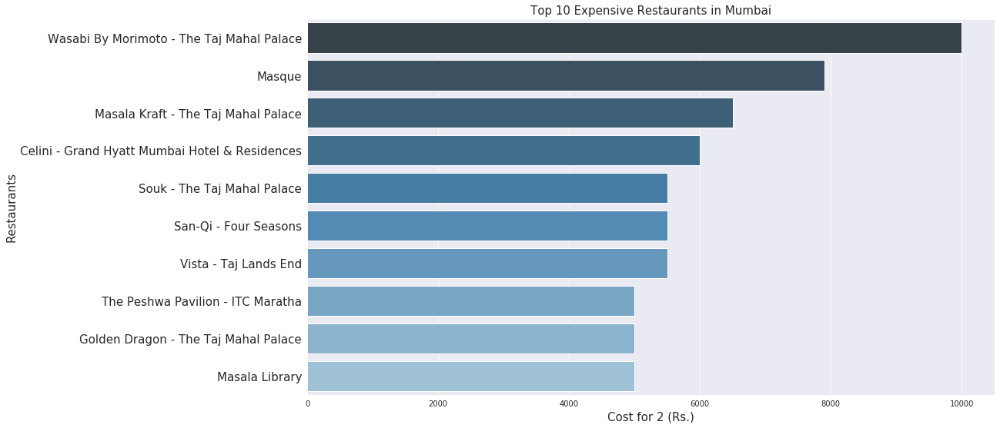

In [19]:
top_10_expensive = r.sort_values(by=['cost'], ascending=False).head(10)

plt.figure(figsize=(16,9))
sns.set_style('darkgrid')
sns.barplot('cost', 'names', data=top_10_expensive, palette="Blues_d")
plt.yticks(fontsize=15)
plt.xlabel('Cost for 2 (Rs.)', fontsize=15)
plt.ylabel('Restaurants', fontsize=15)
plt.title('Top 10 Expensive Restaurants in Mumbai', fontsize=15)
plt.savefig('../images/top_exp.png', bbox_inches='tight')

Text(0.5, 1.0, 'Top 10 Cheapest Restaurants in Mumbai')

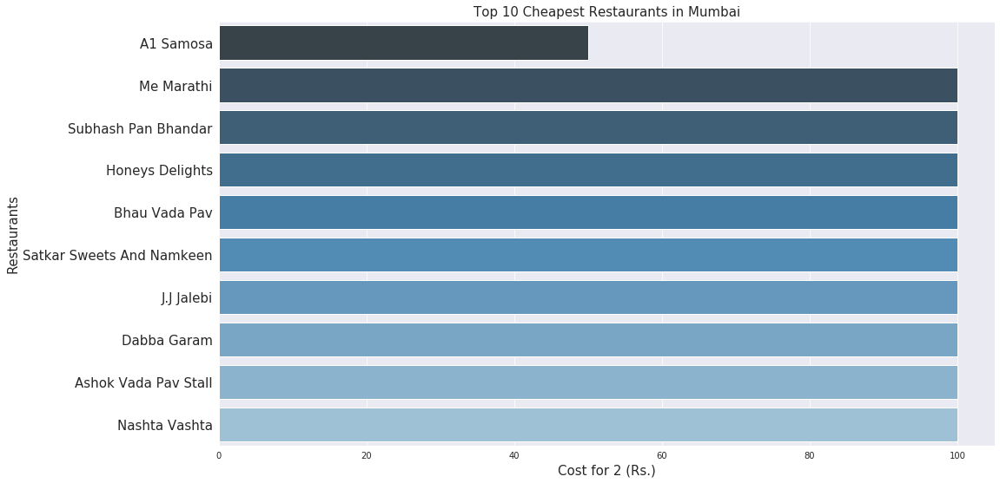

In [20]:
top_10_cheap = r.sort_values(by=['cost'], ascending=True).head(10)

plt.figure(figsize=(16,9))
sns.set_style('darkgrid')
sns.barplot('cost', 'names', data=top_10_cheap, palette="Blues_d")
plt.yticks(fontsize=15)
plt.xlabel('Cost for 2 (Rs.)', fontsize=15)
plt.ylabel('Restaurants', fontsize=15)
plt.title('Top 10 Cheapest Restaurants in Mumbai', fontsize=15)

We can see that there's not much variation here. Most of the listings are roadside stalls / fast food vendors which implies that the cost has been rounded off to 100 Rs.

We will now look at the cheapest restaurants in top 100 restaurants

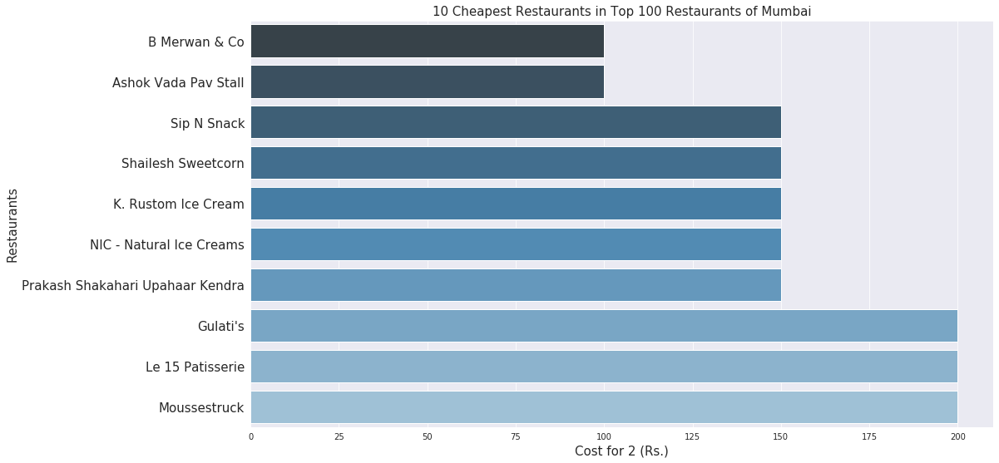

In [22]:
top_100 = r.head(100)
top_10_cheap_100 = top_100.sort_values(by=['cost'], ascending=True).head(10)

plt.figure(figsize=(16,9))
sns.set_style('darkgrid')
sns.barplot('cost', 'names', data=top_10_cheap_100, palette="Blues_d")
plt.yticks(fontsize=15)
plt.xlabel('Cost for 2 (Rs.)', fontsize=15)
plt.ylabel('Restaurants', fontsize=15)
plt.title('10 Cheapest Restaurants in Top 100 Restaurants of Mumbai', fontsize=15)
plt.savefig('../images/cheap_t100.png', bbox_inches='tight')

Most popular (frequent) locations in Mumbai

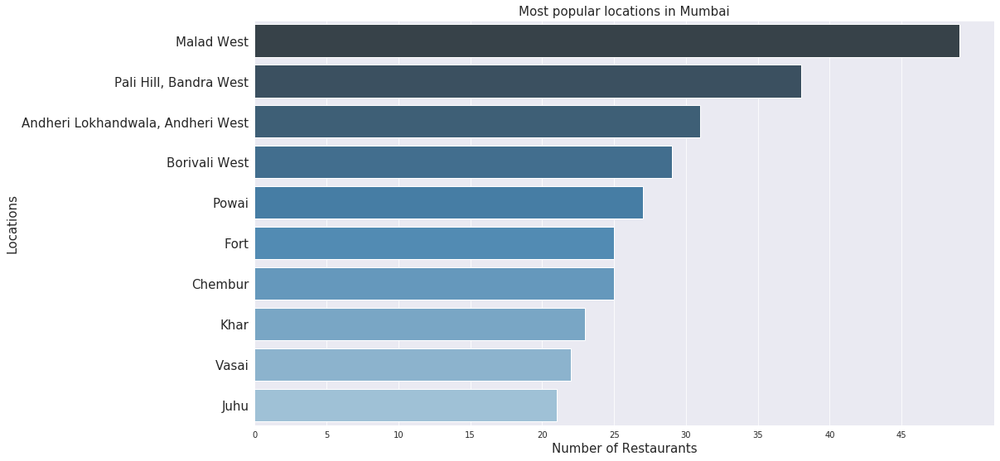

In [23]:
r_by_location =  r.groupby(['location_x']).count()
r_by_location_10 = r_by_location.sort_values(by='names', ascending=False).head(10)

plt.figure(figsize=(16,9))
sns.set_style('darkgrid')
sns.barplot('names', r_by_location_10.index, data=r_by_location_10, palette="Blues_d")
plt.yticks(fontsize=15)
plt.xlabel('Number of Restaurants', fontsize=15)
plt.ylabel('Locations', fontsize=15)
plt.title('Most popular locations in Mumbai', fontsize=15)
plt.xticks(np.arange(0,50,5))
plt.savefig('../images/pop_loc.png', bbox_inches='tight')

Where are the highest rated restaurants located?

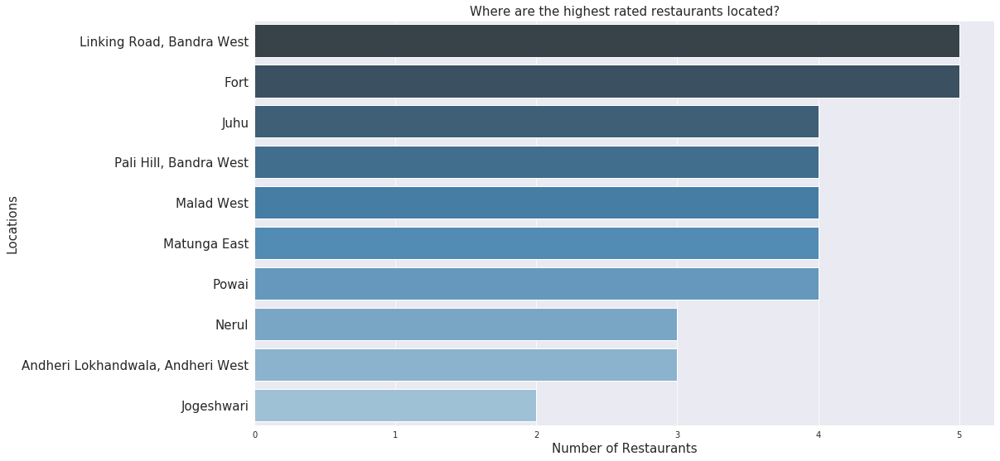

In [24]:
r_by_location_100 =  top_100.groupby(['location_x']).count()
r_by_location_100_10 = r_by_location_100.sort_values(by='names', ascending=False).head(10)

plt.figure(figsize=(16,9))
sns.set_style('darkgrid')
sns.barplot('names', r_by_location_100_10.index, data=r_by_location_100_10, palette="Blues_d")
plt.yticks(fontsize=15)
plt.xlabel('Number of Restaurants', fontsize=15)
plt.ylabel('Locations', fontsize=15)
plt.title('Where are the highest rated restaurants located?', fontsize=15)
plt.savefig('../images/high_rated_loc.png', bbox_inches='tight')

In [25]:
# only considering the primary category and cuisine.

r['category'] = r['category'].apply(lambda x : None if x is np.nan else x[0])

r['cuisine'] = r['cuisine'].apply(lambda x : None if x is np.nan else x[0])

cuisine analysis

most popular cuisines

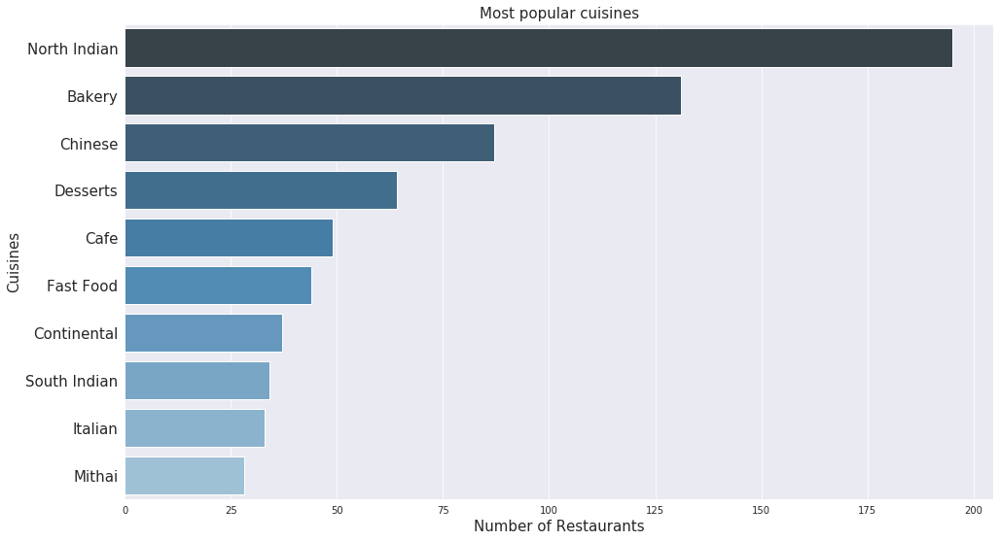

In [26]:
r_by_cuisine =  r.groupby(['cuisine']).count()
r_by_cuisine_10 = r_by_cuisine.sort_values(by='names', ascending=False).head(10)

plt.figure(figsize=(16,9))
sns.set_style('darkgrid')
sns.barplot('names', r_by_cuisine_10.index, data=r_by_cuisine_10, palette="Blues_d")
plt.yticks(fontsize=15)
plt.xlabel('Number of Restaurants', fontsize=15)
plt.ylabel('Cuisines', fontsize=15)
plt.title('Most popular cuisines', fontsize=15)
plt.savefig('../images/pop_cuisine.png', bbox_inches='tight')

In [27]:
r_by_cuisine_mean =  r.groupby(['cuisine']).mean()

Average Rating across cuisines

Text(0.5, 1.0, 'Average Rating across cuisines')

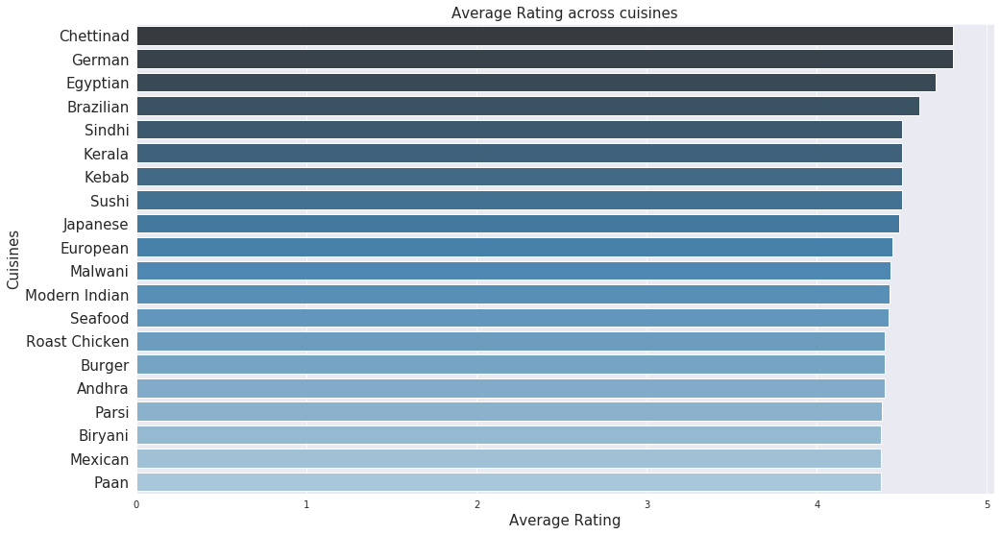

In [28]:
r_by_cuisine_mean_10 = r_by_cuisine_mean.sort_values(by='rating', ascending=False).head(20)

plt.figure(figsize=(16,9))
sns.set_style('darkgrid')
sns.barplot('rating', r_by_cuisine_mean_10.index, data=r_by_cuisine_mean_10, palette="Blues_d")
plt.yticks(fontsize=15)
plt.xlabel('Average Rating', fontsize=15)
plt.ylabel('Cuisines', fontsize=15)
plt.title('Average Rating across cuisines', fontsize=15)

All the cuisines have an avg rating above 4.0

Text(0.5, 1.0, 'Average number of Reviews across cuisines')

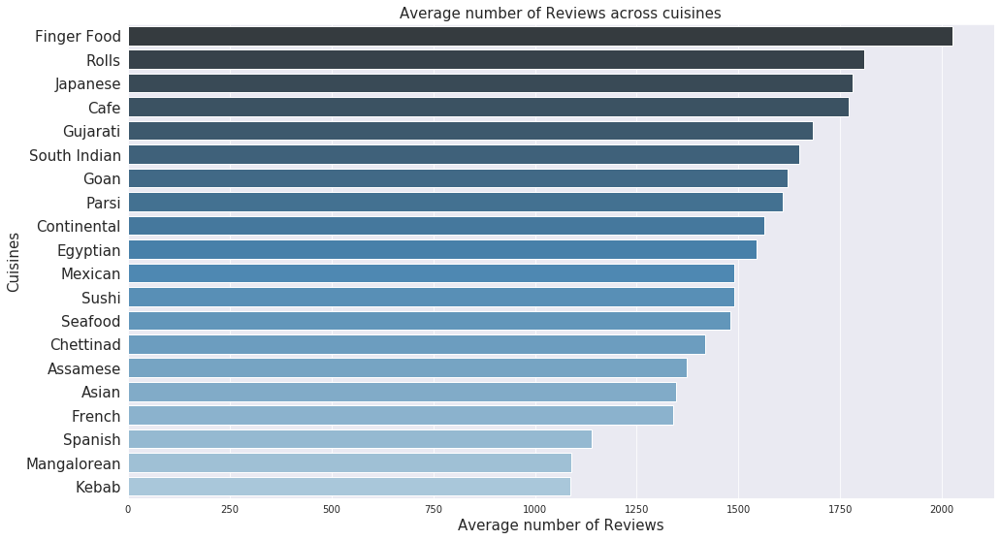

In [29]:
# reviews
r_by_cuisine_mean_10 = r_by_cuisine_mean.sort_values(by='reviews', ascending=False).head(20)

plt.figure(figsize=(16,9))
sns.set_style('darkgrid')
sns.barplot('reviews', r_by_cuisine_mean_10.index, data=r_by_cuisine_mean_10, palette="Blues_d")
plt.yticks(fontsize=15)
plt.xlabel('Average number of Reviews', fontsize=15)
plt.ylabel('Cuisines', fontsize=15)
plt.title('Average number of Reviews across cuisines', fontsize=15)

Text(0.5, 1.0, 'Average Cost for 2  across cuisines')

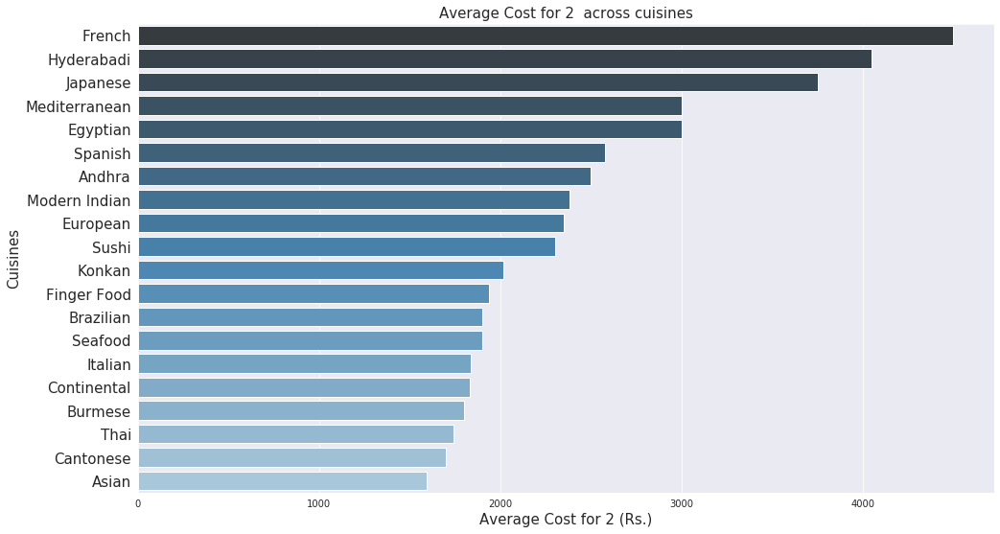

In [30]:
# cost for 2
r_by_cuisine_mean_10 = r_by_cuisine_mean.sort_values(by='cost', ascending=False).head(20)

plt.figure(figsize=(16,9))
sns.set_style('darkgrid')
sns.barplot('cost', r_by_cuisine_mean_10.index, data=r_by_cuisine_mean_10, palette="Blues_d")
plt.yticks(fontsize=15)
plt.xlabel('Average Cost for 2 (Rs.)', fontsize=15)
plt.ylabel('Cuisines', fontsize=15)
plt.title('Average Cost for 2  across cuisines', fontsize=15)

French cuisine is the most expensive in Mumbai, followed by Hyderabadi.

restaurant category analysis

In [31]:
r_by_cate_count = r.groupby('category').count()
r_by_cate_mean = r.groupby('category').mean()

([<matplotlib.axis.XTick at 0x7f0a1cb37990>,
 <a list of 13 Text xticklabel objects>)

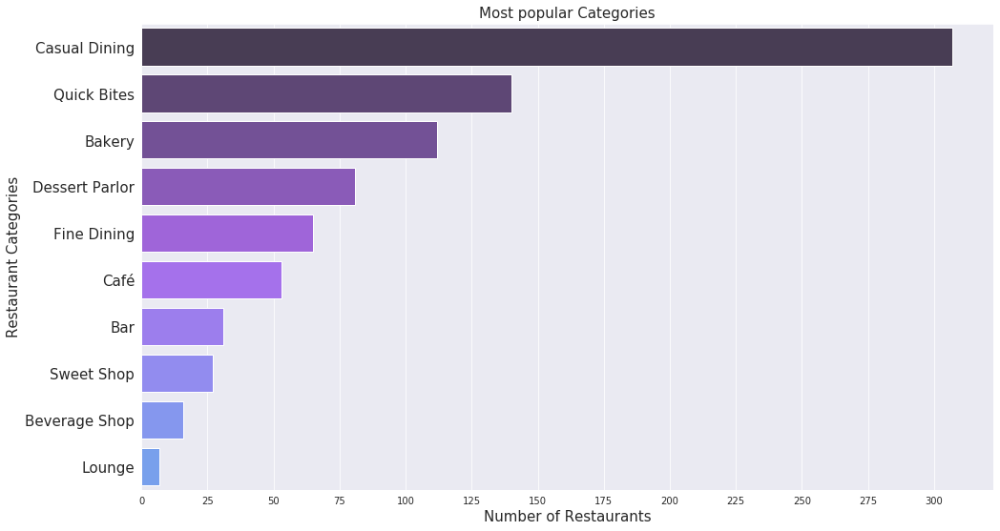

In [32]:
# count
r_by_cate_count_10 = r_by_cate_count.sort_values(by='names', ascending=False).head(10)

plt.figure(figsize=(16,9))
sns.set_style('darkgrid')
sns.barplot('names', r_by_cate_count_10.index, data=r_by_cate_count_10, palette="cool_d")
plt.yticks(fontsize=15)
plt.xlabel('Number of Restaurants', fontsize=15)
plt.ylabel('Restaurant Categories', fontsize=15)
plt.title('Most popular Categories', fontsize=15)
plt.xticks(np.arange(0,325,25))

Casual dining is the most popular category by a vast margin, followed by quick bites and bakery.

Text(0.5, 1.0, 'Average Rating across Categories')

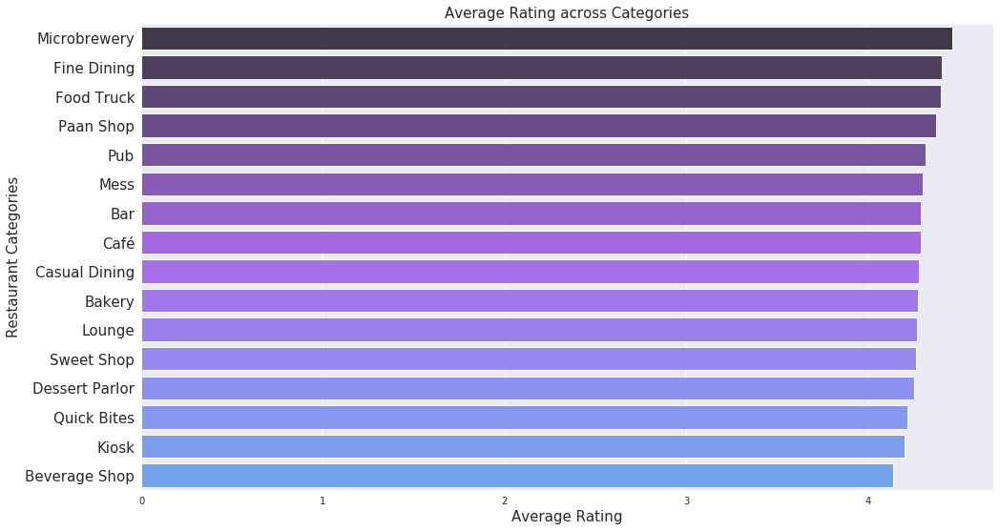

In [33]:
# rating
r_by_cate_mean_20 = r_by_cate_mean.sort_values(by='rating', ascending=False).head(20)

plt.figure(figsize=(16,9))
sns.set_style('darkgrid')
sns.barplot('rating', r_by_cate_mean_20.index, data=r_by_cate_mean_20, palette="cool_d")
plt.yticks(fontsize=15)
plt.xlabel('Average Rating', fontsize=15)
plt.ylabel('Restaurant Categories', fontsize=15)
plt.title('Average Rating across Categories', fontsize=15)

All the categories have an avg rating above 4.0

([<matplotlib.axis.XTick at 0x7f0a50089210>,
 <a list of 12 Text xticklabel objects>)

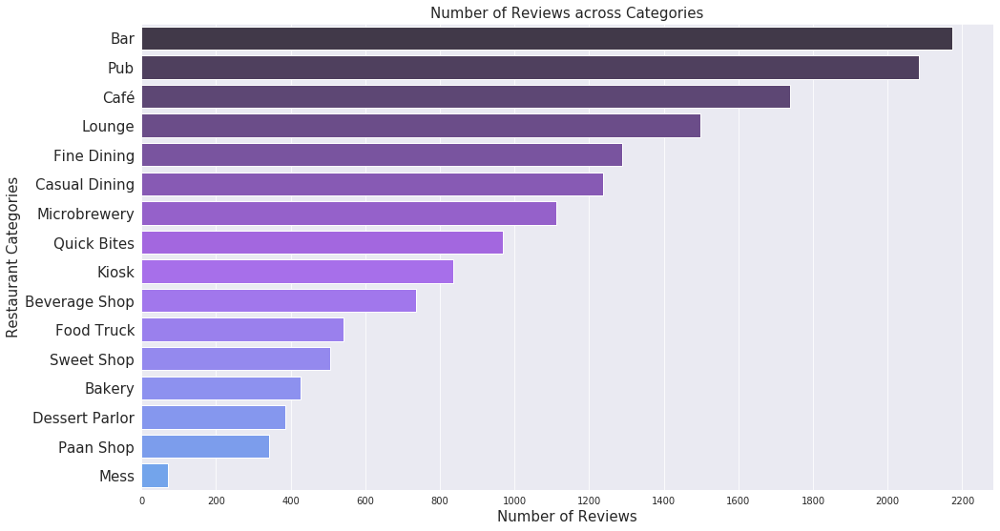

In [34]:
#reviews
r_by_cate_mean_20 = r_by_cate_mean.sort_values(by='reviews', ascending=False).head(20)

plt.figure(figsize=(16,9))
sns.set_style('darkgrid')
sns.barplot('reviews', r_by_cate_mean_20.index, data=r_by_cate_mean_20, palette="cool_d")
plt.yticks(fontsize=15)
plt.xlabel('Number of Reviews', fontsize=15)
plt.ylabel('Restaurant Categories', fontsize=15)
plt.title('Number of Reviews across Categories', fontsize=15)
plt.xticks(np.arange(0,2300,200))

([<matplotlib.axis.XTick at 0x7f0a180440d0>,
 <a list of 20 Text xticklabel objects>)

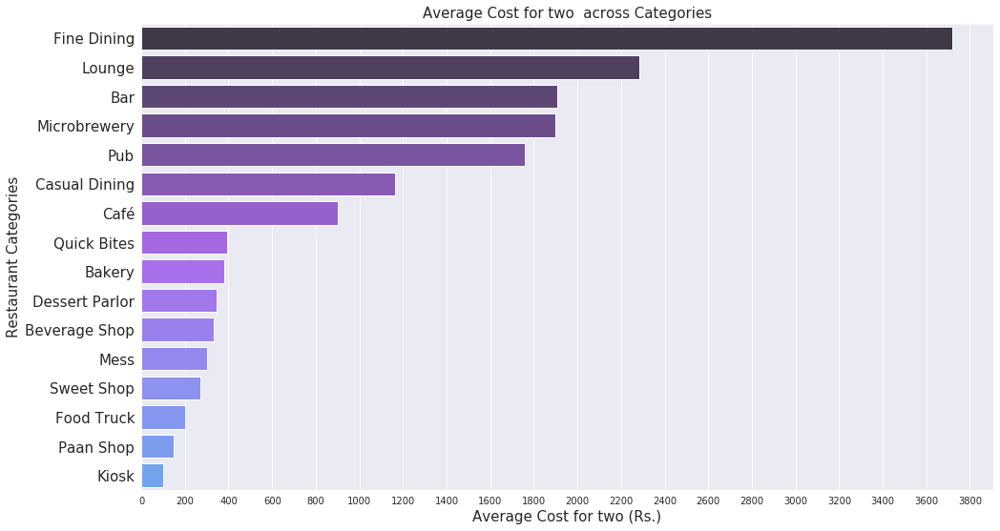

In [35]:
# cost
r_by_cate_mean_20 = r_by_cate_mean.sort_values(by='cost', ascending=False).head(20)

plt.figure(figsize=(16,9))
sns.set_style('darkgrid')
sns.barplot('cost', r_by_cate_mean_20.index, data=r_by_cate_mean_20, palette="cool_d")
plt.yticks(fontsize=15)
plt.xlabel('Average Cost for two (Rs.)', fontsize=15)
plt.ylabel('Restaurant Categories', fontsize=15)
plt.title('Average Cost for two  across Categories', fontsize=15)
plt.xticks(np.arange(0,3900,200))

As expected, Fine dining is the most expensive category, followed by lounge, bar, brewery and pub (all of which serve liquor, driving the price up.)

location analysis

In [37]:
r_by_loc_mean =  r.groupby(['location_x']).mean()

Text(0.5, 1.0, 'Average Rating across Locations')

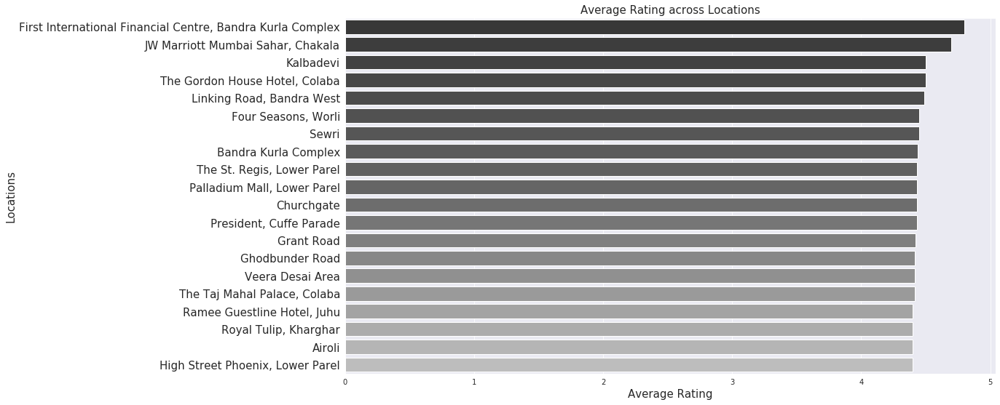

In [38]:
# rating
r_by_loc_mean_20 = r_by_loc_mean.sort_values(by='rating', ascending=False).head(20)

plt.figure(figsize=(16,9))
sns.set_style('darkgrid')
sns.barplot('rating', r_by_loc_mean_20.index, data=r_by_loc_mean_20, palette="Greys_d")
plt.yticks(fontsize=15)
plt.xlabel('Average Rating', fontsize=15)
plt.ylabel('Locations', fontsize=15)
plt.title('Average Rating across Locations', fontsize=15)

([<matplotlib.axis.XTick at 0x7f0a13ccf450>,
 <a list of 17 Text xticklabel objects>)

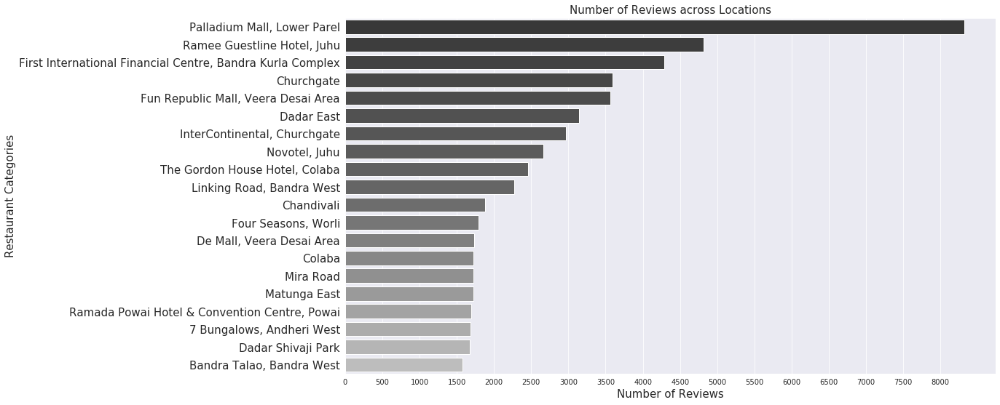

In [39]:
# reviews
r_by_loc_mean_20 = r_by_loc_mean.sort_values(by='reviews', ascending=False).head(20)

plt.figure(figsize=(16,9))
sns.set_style('darkgrid')
sns.barplot('reviews', r_by_loc_mean_20.index, data=r_by_loc_mean_20, palette="Greys_d")
plt.yticks(fontsize=15)
plt.xlabel('Number of Reviews', fontsize=15)
plt.ylabel('Restaurant Categories', fontsize=15)
plt.title('Number of Reviews across Locations', fontsize=15)
plt.xticks(np.arange(0,8500,500))

Palladium mall has the most number of reviews on avg, as it is a mall which contains a large number of restaurants and eateries. On a similar note, most of these locations are malls or shopping centres.

([<matplotlib.axis.XTick at 0x7f0a13e3fcd0>,
 <a list of 13 Text xticklabel objects>)

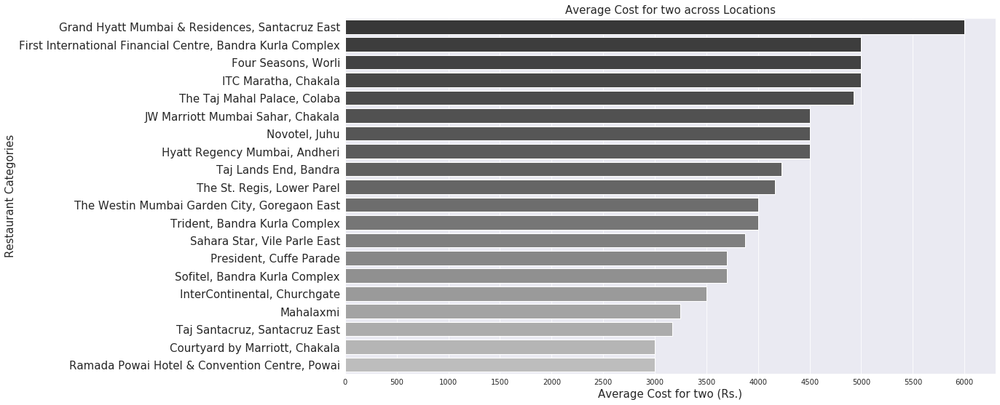

In [40]:
# cost
r_by_loc_mean_20 = r_by_loc_mean.sort_values(by='cost', ascending=False).head(20)

plt.figure(figsize=(16,9))
sns.set_style('darkgrid')
sns.barplot('cost', r_by_loc_mean_20.index, data=r_by_loc_mean_20, palette="Greys_d")
plt.yticks(fontsize=15)
plt.xlabel('Average Cost for two (Rs.)', fontsize=15)
plt.ylabel('Restaurant Categories', fontsize=15)
plt.title('Average Cost for two across Locations', fontsize=15)
plt.xticks(np.arange(0,6500,500))

The above list is dominated by 5 star Hotels, as expected.

Cost for 2 in 10 best rest for each of the top 3 location (Malad west, pali hill, lokhandwala)

([<matplotlib.axis.XTick at 0x7f0a182c9910>,
 <a list of 12 Text xticklabel objects>)

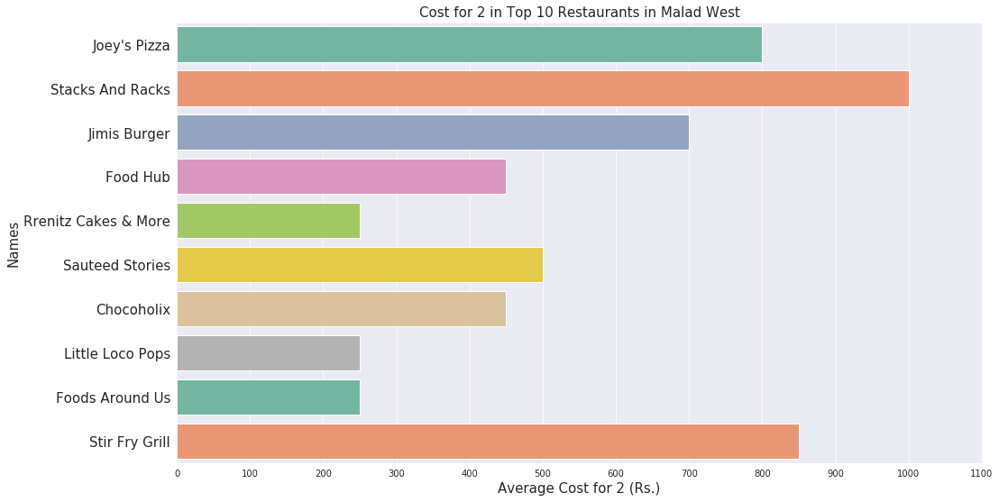

In [41]:
malad = r[r['location_x']=='Malad West'].sort_values('rating', ascending=False).head(10)

plt.figure(figsize=(16,9))
sns.set_style('darkgrid')
sns.barplot('cost', 'names', data=malad, palette="Set2")
plt.yticks(fontsize=15)
plt.xlabel('Average Cost for 2 (Rs.)', fontsize=15)
plt.ylabel('Names', fontsize=15)
plt.title('Cost for 2 in Top 10 Restaurants in Malad West', fontsize=15)
plt.xticks(np.arange(0,1200,100))

([<matplotlib.axis.XTick at 0x7f0a19cfccd0>,
 <a list of 16 Text xticklabel objects>)

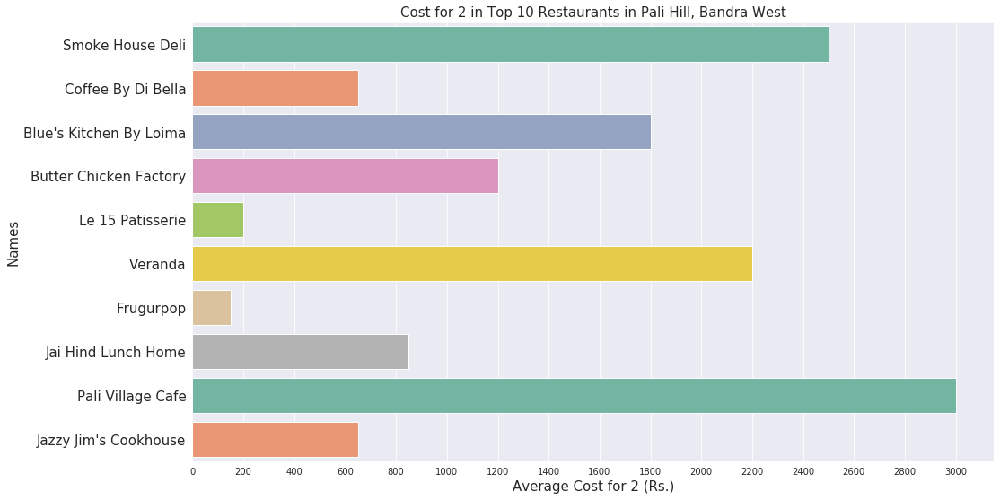

In [42]:
pali = r[r['location_x']=='Pali Hill, Bandra West'].sort_values('rating', ascending=False).head(10)

plt.figure(figsize=(16,9))
sns.set_style('darkgrid')
sns.barplot('cost', 'names', data=pali, palette="Set2")
plt.yticks(fontsize=15)
plt.xlabel('Average Cost for 2 (Rs.)', fontsize=15)
plt.ylabel('Names', fontsize=15)
plt.title('Cost for 2 in Top 10 Restaurants in Pali Hill, Bandra West', fontsize=15)
plt.xticks(np.arange(0,3200,200))

([<matplotlib.axis.XTick at 0x7f0a13e87e90>,
 <a list of 13 Text xticklabel objects>)

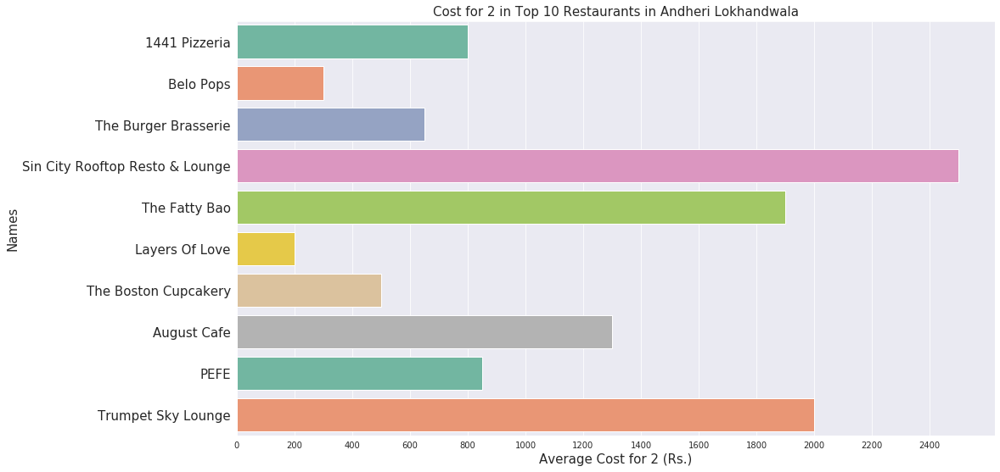

In [43]:
andh = r[r['location_x']=='Andheri Lokhandwala, Andheri West'].sort_values('rating', ascending=False).head(10)

plt.figure(figsize=(16,9))
sns.set_style('darkgrid')
sns.barplot('cost', 'names', data=andh, palette="Set2")
plt.yticks(fontsize=15)
plt.xlabel('Average Cost for 2 (Rs.)', fontsize=15)
plt.ylabel('Names', fontsize=15)
plt.title('Cost for 2 in Top 10 Restaurants in Andheri Lokhandwala', fontsize=15)
plt.xticks(np.arange(0,2600,200))

We will now do some analysis on restaurants that feature in the Best of Mumbai list.

In [44]:
best = []
for x in r['featured']:
    if x is np.nan:
        best.append(0)
    else:
        if ('Best of Mumbai' in x ):
            best.append(1)
        else:
            best.append(0)

In [45]:
r['best_of_mumbai'] = best

In [46]:
best_rest = r[r['best_of_mumbai'] == 1]

In [47]:
best_rest_cuisine = best_rest.groupby('cuisine').count().sort_values('names', ascending=False).head(20)

In [48]:
best_rest_cate = best_rest.groupby('category').count().sort_values('names', ascending=False).head(20)

In [49]:
best_rest_loc = best_rest.groupby('location_x').count().sort_values('names', ascending=False).head(20)

Cuisines of Restaurants that feature in 'Best of Mumbai' list by Zomato

Text(0.5, 1.0, "Cuisines of Restaurants that feature in 'Best of Mumbai' list by Zomato")

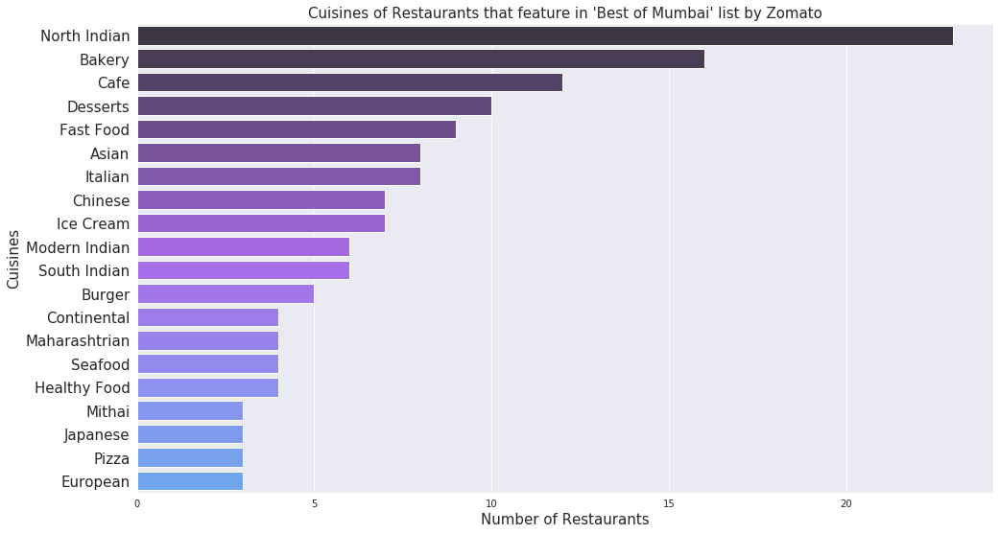

In [50]:
plt.figure(figsize=(16,9))
sns.set_style('darkgrid')
sns.barplot('names', best_rest_cuisine.index, data=best_rest_cuisine, palette="cool_d")
plt.yticks(fontsize=15)
plt.xlabel('Number of Restaurants', fontsize=15)
plt.ylabel('Cuisines', fontsize=15)
plt.title("Cuisines of Restaurants that feature in 'Best of Mumbai' list by Zomato", fontsize=15)

Categories of Restaurants that feature in 'Best of Mumbai' list by Zomato

([<matplotlib.axis.XTick at 0x7f0a1827d710>,
 <a list of 12 Text xticklabel objects>)

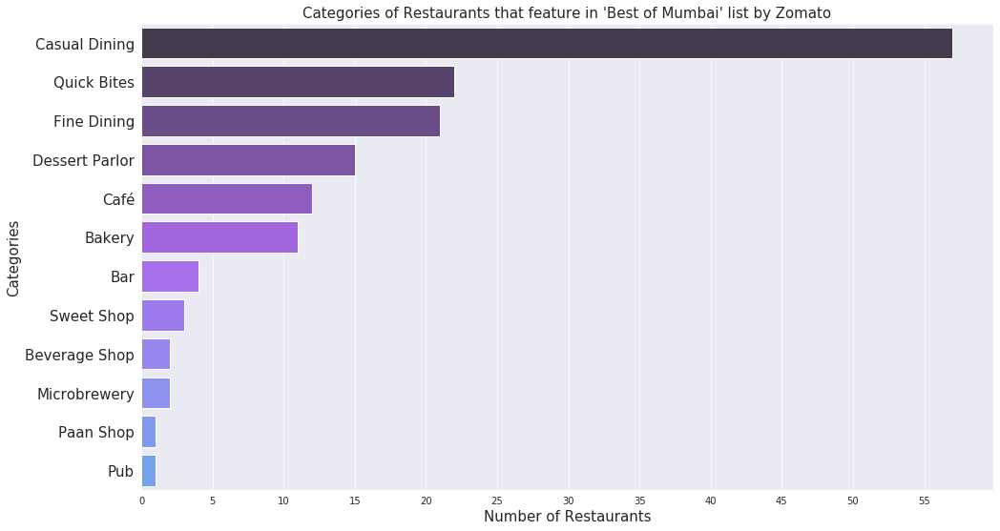

In [51]:
plt.figure(figsize=(16,9))
sns.set_style('darkgrid')
sns.barplot('names', best_rest_cate.index, data=best_rest_cate, palette="cool_d")
plt.yticks(fontsize=15)
plt.xlabel('Number of Restaurants', fontsize=15)
plt.ylabel('Categories', fontsize=15)
plt.title("Categories of Restaurants that feature in 'Best of Mumbai' list by Zomato", fontsize=15)
plt.xticks(np.arange(0,60,5))

Locations of Restaurants that feature in 'Best of Mumbai' list by Zomato

Text(0.5, 1.0, "Locations of Restaurants that feature in 'Best of Mumbai' list by Zomato")

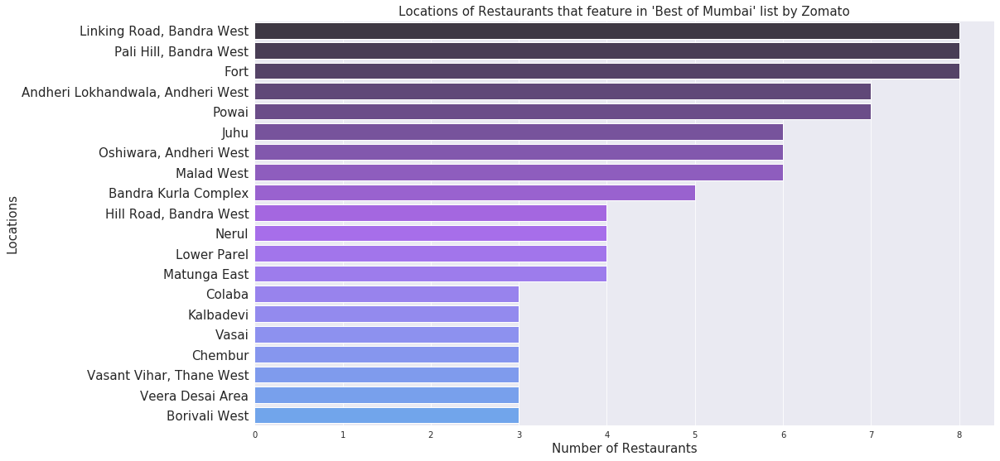

In [52]:
plt.figure(figsize=(16,9))
sns.set_style('darkgrid')
sns.barplot('names', best_rest_loc.index, data=best_rest_loc, palette="cool_d")
plt.yticks(fontsize=15)
plt.xlabel('Number of Restaurants', fontsize=15)
plt.ylabel('Locations', fontsize=15)
plt.title("Locations of Restaurants that feature in 'Best of Mumbai' list by Zomato", fontsize=15)

creating wordclouds for restaurant names and locations.

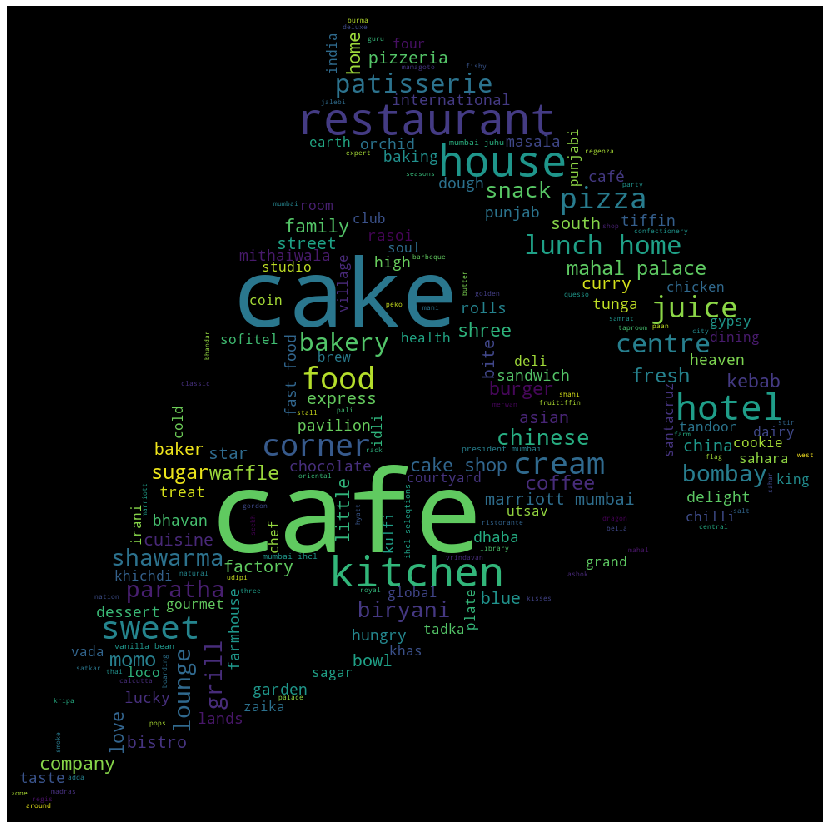

In [54]:
text = " ".join(title for title in r['names'])
dataset = text
def create_word_cloud(string):
   plt.subplots(figsize = (30,15))
   maskArray = np.array(Image.open("../images/pizza.png"))
   cloud = WordCloud(width=800, height=400, min_word_length=4, background_color = "#000000", mask = maskArray)
   cloud.generate(string)
   cloud.to_file("../images/names_wc.png")
   plt.imshow(cloud)
   plt.axis("off")
dataset = dataset.lower()
create_word_cloud(dataset)

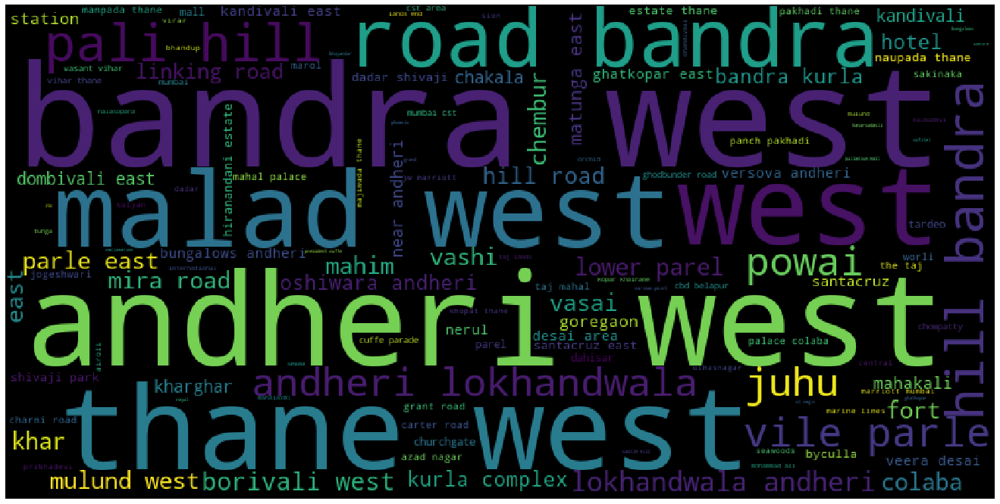

In [59]:
text = " ".join(title for title in r['location_x'])
dataset = text
def create_word_cloud(string):
   plt.subplots(figsize = (24,12))
   cloud = WordCloud(width=800, height=400, background_color = "#000000")
   cloud.generate(string)
   cloud.to_file("../images/loc_wc.png")
   plt.imshow(cloud)
   plt.axis("off")
dataset = dataset.lower()
create_word_cloud(dataset)

now we will perform analysis on restaurants located near given co-ordinates. we will use the haversine formula to find the distance between two gps co-ordinates.

In [60]:
def haversine_distance(lat1, lon1, lat2, lon2):
   r = 6371
   phi1 = np.radians(lat1)
   phi2 = np.radians(lat2)
   delta_phi = np.radians(lat2 - lat1)
   delta_lambda = np.radians(lon2 - lon1)
   a = np.sin(delta_phi / 2)**2 + np.cos(phi1) * np.cos(phi2) *   np.sin(delta_lambda / 2)**2
   res = r * (2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a)))
   return np.round(res, 2)

In [61]:
start_lat, start_lon = 19.069729, 72.833809 # enter your co ordinates here

In [62]:
distances_km = []
for row in r.itertuples(index=False):
   distances_km.append(
       haversine_distance(start_lat, start_lon, row.lat, row.lon)
   )

In [63]:
r['dist_from_my_loc'] = distances_km

In [64]:
r_closest = r.sort_values('dist_from_my_loc').head(20)

In [65]:
r_closest_rated = r_closest.sort_values('rating', ascending=False)

Average Rating of Restaurants Near given co-ordinates

Text(0.5, 1.0, 'Average Rating of Restaurants Near Me')

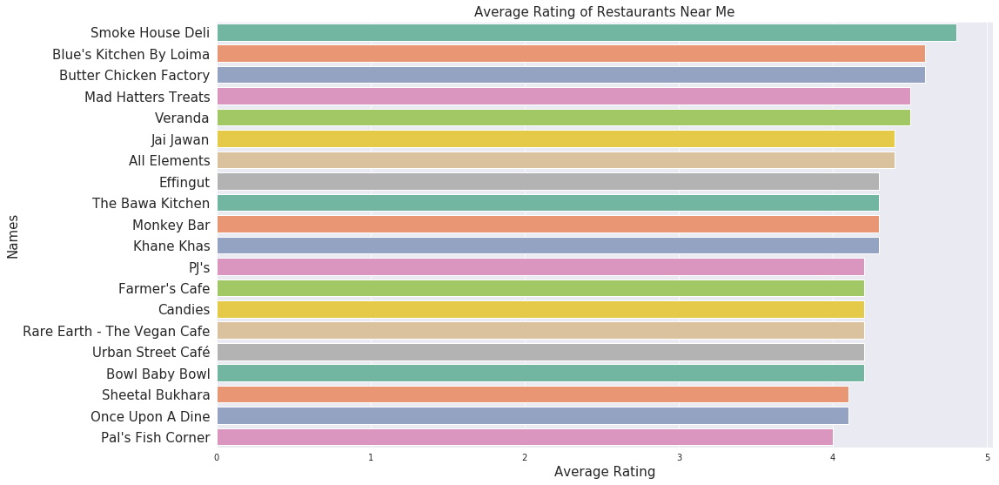

In [66]:
plt.figure(figsize=(16,9))
sns.set_style('darkgrid')
sns.barplot('rating', 'names', data=r_closest_rated, palette="Set2")
plt.yticks(fontsize=15)
plt.xlabel('Average Rating', fontsize=15)
plt.ylabel('Names', fontsize=15)
plt.title('Average Rating of Restaurants Near Me', fontsize=15)

Average Cost for two in Restaurants Near Me

In [68]:
r_closest_exp = r_closest.sort_values('cost', ascending=False)

Text(0.5, 1.0, 'Average Cost for 2 in Restaurants Near Me')

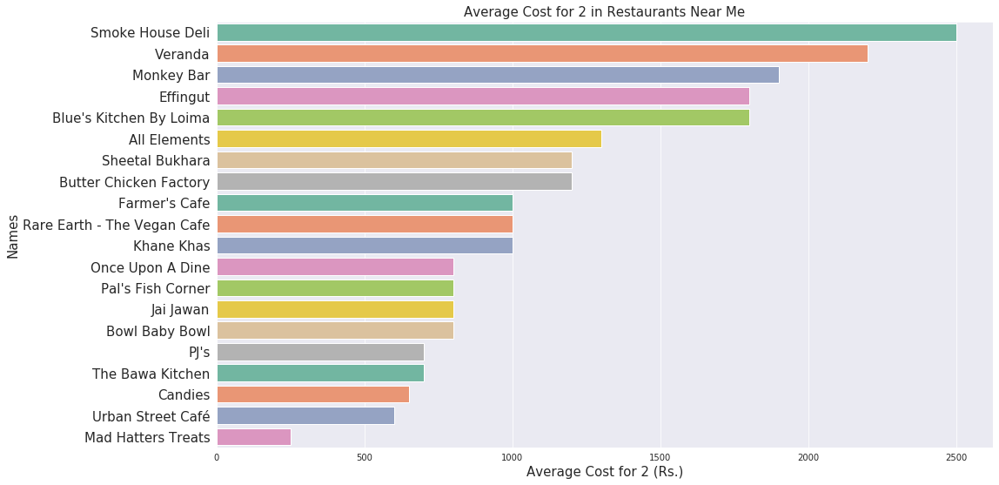

In [69]:
plt.figure(figsize=(16,9))
sns.set_style('darkgrid')
sns.barplot('cost', 'names', data=r_closest_exp, palette="Set2")
plt.yticks(fontsize=15)
plt.xlabel('Average Cost for 2 (Rs.)', fontsize=15)
plt.ylabel('Names', fontsize=15)
plt.title('Average Cost for 2 in Restaurants Near Me', fontsize=15)

plotting restaurants on map segregated by cost

In [70]:
geometry = [Point(xy) for xy in zip(r['lon'],r['lat'])]

geo_df = gpd.GeoDataFrame(r, geometry = geometry)

roads = gpd.read_file('/home/ritik/data73/zomato/Bombay-shp/shape/roads.shp')

Text(0.48, 0.1, 'Cost for 2 in Top 1000 Restaurants in Mumbai')

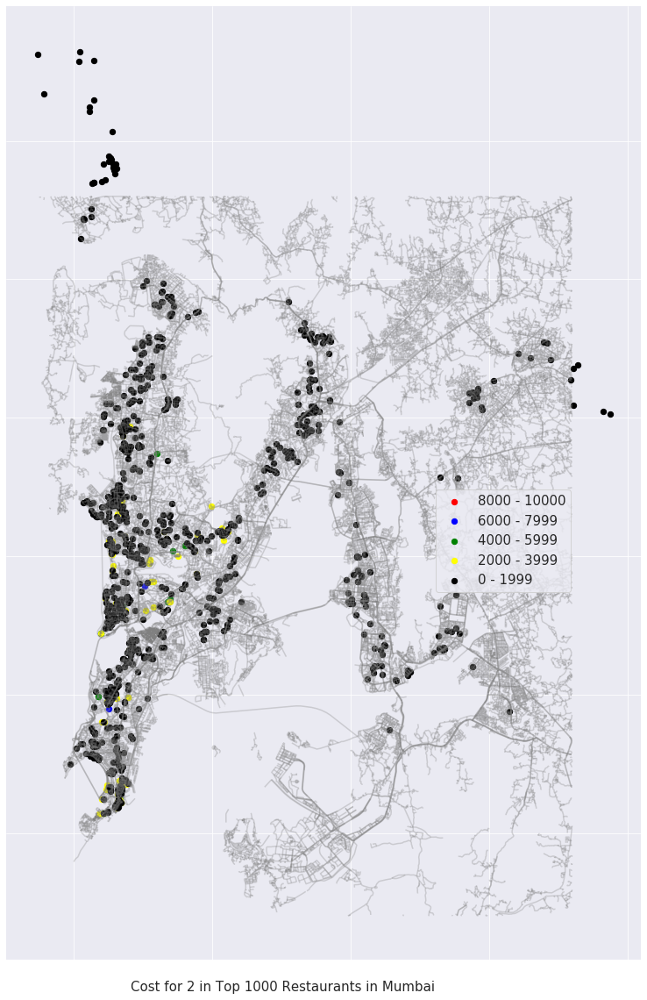

In [71]:
fig, ax = plt.subplots(figsize=(20,20))
roads.plot(ax=ax, alpha=0.3, color='grey')
geo_df[geo_df['cost']>=8000].plot(ax=ax, markersize=40, color='red', marker='o',label='8000 - 10000')
geo_df[(geo_df['cost']>=6000) & (geo_df['cost']<=7999)].plot(ax=ax, markersize=40, color='blue', marker='o',label='6000 - 7999')
geo_df[(geo_df['cost']>=4000) & (geo_df['cost']<=5999)].plot(ax=ax, markersize=40, color='green', marker='o',label='4000 - 5999')
geo_df[(geo_df['cost']>=2000) & (geo_df['cost']<=3999)].plot(ax=ax, markersize=40, color='yellow', marker='o',label='2000 - 3999')
geo_df[geo_df['cost']<=1999].plot(ax=ax, markersize=40, color='black', marker='o',label='0 - 1999')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)

ax.axes.xaxis.set_ticklabels([])
ax.axes.yaxis.set_ticklabels([])
plt.legend(prop={'size':15},bbox_to_anchor=(0.9,0.5))
txt = 'Cost for 2 in Top 1000 Restaurants in Mumbai'
fig.text(.48, 0.1, txt, ha='center',fontsize=15)
plt.savefig('../images/cost_map.png', bbox_inches='tight')